In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from torch.utils import data
from torchvision import transforms as T
from torchvision.datasets import ImageFolder
from PIL import Image
import torch
import os
import random
import argparse
import json
from torch.backends import cudnn
from tensorboardX import SummaryWriter
import pandas as pd
import time
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import glob
import shutil
from IPython.display import FileLink

# from networks.Generator import Generator
# from networks.Discriminator import Discriminator
# from dataProcess.data_loader import getProperLoader
# from trains.train import train

## DataLoader

In [3]:
class CelebA(data.Dataset):
    """Dataset class for the CelebA dataset."""

    def __init__(self, image_dir, attr_path, selected_attrs, transform, mode):
        """Initialize and preprocess the CelebA dataset."""
        self.image_dir = image_dir
        self.attr_path = attr_path
        self.selected_attrs = selected_attrs
        self.transform = transform
        self.mode = mode
        self.train_dataset = []
        self.test_dataset = []
        self.attr2idx = {}
        self.idx2attr = {}
        self.preprocess()

        if mode == 'train':
            self.num_images = len(self.train_dataset)
        else:
            self.num_images = len(self.test_dataset)


    def preprocess(self):
        """Preprocess the CelebA attribute file."""
        df = pd.read_csv(self.attr_path)
        df = df.sample(frac=1, random_state=42).reset_index(drop=True)
        all_attr_names = df.columns
        for i, attr_name in enumerate(all_attr_names[1:]):
            self.attr2idx[attr_name] = i
            self.idx2attr[i] = attr_name
            
        for i, row in df.iterrows(): #Iterating over all the rows of dataset
            filename = row.iloc[0]  # Assuming the first column is the filename
            values = row.iloc[1:]   # The remaining columns are the attributes
            label = []
            # selected_attrs: (like) ['Black_Hair', 'Blond_Hair', 'Brown_Hair', 'Male', 'Young']
            for attr_name in self.selected_attrs:
                idx = self.attr2idx[attr_name]        
                if idx >= len(values):
                    raise IndexError(f"Index {idx} is out-of-bounds for values with length {len(values)}.")
                label.append(values.iloc[idx] == 1) # [0,0,0,0,0,1]
#             print(label)
            # Append to test or train dataset based on the row index
            if (i+1) < 2000:
                self.test_dataset.append([filename, label])
            else:
                self.train_dataset.append([filename, label])
        print('Finished preprocessing the CelebA dataset...')
#         raise IndexError(f"")

    def __getitem__(self, index):
        """Return one image and its corresponding attribute label."""
        dataset = self.train_dataset if self.mode == 'train' else self.test_dataset
        filename, label = dataset[index]
        image = Image.open(os.path.join(self.image_dir, filename))
        return self.transform(image), torch.FloatTensor(label)

    def __len__(self):
        """Return the number of images."""
        return self.num_images


def get_loader(image_dir, attr_path, selected_attrs, crop_size=178, image_size=128,
               batch_size=16, dataset='CelebA', mode='train', num_workers=1):
    """Build and return a data loader."""
    transform = []
    if mode == 'train':
        transform.append(T.RandomHorizontalFlip())
    transform.append(T.CenterCrop(crop_size))
    transform.append(T.Resize(image_size))
    transform.append(T.ToTensor())
    transform.append(T.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)))
    transform = T.Compose(transform)

    if dataset == 'CelebA':
        dataset = CelebA(image_dir, attr_path, selected_attrs, transform, mode)
    elif dataset == 'RaFD':
        dataset = ImageFolder(image_dir, transform)

    data_loader = data.DataLoader(dataset=dataset,
                                  batch_size=batch_size,
                                  shuffle=(mode=='train'),
                                  num_workers=num_workers)
    return data_loader

def getProperLoader(config):
    # Data loader.
    celeba_loader = None
    rafd_loader = None
    # Data loader.
    if config.dataset in ['CelebA', 'Both']:
        celeba_loader = get_loader(config.celeba_image_dir, config.attr_path, config.selected_attrs,
                                   config.celeba_crop_size, config.image_size, config.batch_size,
                                   'CelebA', config.mode, config.num_workers)
    if config.dataset in ['RaFD', 'Both']:
        rafd_loader = get_loader(config.rafd_image_dir, None, None,
                                 config.rafd_crop_size, config.image_size, config.batch_size,
                                 'RaFD', config.mode, config.num_workers)
    data_loader = celeba_loader if config.dataset == 'CelebA' else rafd_loader if config.dataset == 'RaFD' else None
    assert data_loader is not None, "data_loader is not properly set."
    return data_loader

## Model

In [4]:
class ResidualBlock(nn.Module):
    """Residual Block with instance normalization."""
    def __init__(self, dim_in, dim_out):
        super(ResidualBlock, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(dim_in, dim_out, kernel_size=3, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(dim_out, affine=True, track_running_stats=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(dim_out, dim_out, kernel_size=3, stride=1, padding=1, bias=False),
            nn.InstanceNorm2d(dim_out, affine=True, track_running_stats=True))

    def forward(self, x):
        return x + self.main(x)


class Generator(nn.Module):
    """Generator network."""
    def __init__(self, conv_dim=64, c_dim=5, repeat_num=6):
        super(Generator, self).__init__()

        layers = []
        layers.append(nn.Conv2d(3+c_dim, conv_dim, kernel_size=7, stride=1, padding=3, bias=False))
        layers.append(nn.InstanceNorm2d(conv_dim, affine=True, track_running_stats=True))
        layers.append(nn.ReLU(inplace=True))

        # Down-sampling layers.
        curr_dim = conv_dim
        for i in range(2):
            layers.append(nn.Conv2d(curr_dim, curr_dim*2, kernel_size=4, stride=2, padding=1, bias=False))
            layers.append(nn.InstanceNorm2d(curr_dim*2, affine=True, track_running_stats=True))
            layers.append(nn.ReLU(inplace=True))
            curr_dim = curr_dim * 2

        # Bottleneck layers.
        for i in range(repeat_num):
            layers.append(ResidualBlock(dim_in=curr_dim, dim_out=curr_dim))

        # Up-sampling layers.
        for i in range(2):
            layers.append(nn.ConvTranspose2d(curr_dim, curr_dim//2, kernel_size=4, stride=2, padding=1, bias=False))
            layers.append(nn.InstanceNorm2d(curr_dim//2, affine=True, track_running_stats=True))
            layers.append(nn.ReLU(inplace=True))
            curr_dim = curr_dim // 2

        layers.append(nn.Conv2d(curr_dim, 3, kernel_size=7, stride=1, padding=3, bias=False))
        layers.append(nn.Tanh())
        self.main = nn.Sequential(*layers)

    def forward(self, x, c):
        """
        For skip input of label c, c should be original label, not already tiled (which disable c input for shrinked/expanded layers)
        """
        # Replicate spatially and concatenate domain information.
        c = c.view(c.size(0), c.size(1), 1, 1)
        c = c.repeat(1, 1, x.size(2), x.size(3))
        x = torch.cat([x, c], dim=1)
        return self.main(x)

In [5]:
class Discriminator(nn.Module):
    """Discriminator network with PatchGAN."""
    def __init__(self, image_size=128, conv_dim=64, c_dim=5, repeat_num=6):
        super(Discriminator, self).__init__()
        layers = []
        layers.append(nn.Conv2d(3, conv_dim, kernel_size=4, stride=2, padding=1))
        layers.append(nn.LeakyReLU(0.01))

        curr_dim = conv_dim
        for i in range(1, repeat_num):
            layers.append(nn.Conv2d(curr_dim, curr_dim*2, kernel_size=4, stride=2, padding=1))
            layers.append(nn.LeakyReLU(0.01))
            curr_dim = curr_dim * 2

        kernel_size = int(image_size / np.power(2, repeat_num))
        self.main = nn.Sequential(*layers)
        self.conv1 = nn.Conv2d(curr_dim, 1, kernel_size=3, stride=1, padding=1, bias=False)
        self.conv2 = nn.Conv2d(curr_dim, c_dim, kernel_size=kernel_size, bias=False)

    def forward(self, x):
        h = self.main(x)
        out_src = self.conv1(h)
        out_cls = self.conv2(h)
        return out_src, out_cls.view(out_cls.size(0), out_cls.size(1))

## Train function

In [6]:
def label2onehot(labels, dim):
    """Convert label indices to one-hot vectors."""
    batch_size = labels.size(0)
    out = torch.zeros(batch_size, dim)
    out[np.arange(batch_size), labels.long()] = 1
    return out

def classification_loss(logit, target, dataset):
    if dataset == 'CelebA':
        # Use reduction='sum' and divide by the batch size manually to maintain behavior
        return F.binary_cross_entropy_with_logits(logit, target, reduction='sum') / logit.size(0)
    elif dataset == 'RaFD':
        # For multi-class classification
        return F.cross_entropy(logit, target)
    else:
        raise ValueError(f"Unsupported dataset: {dataset}")

def train(config, G, D, g_optimizer, d_optimizer, data_loader, device, writer, iters):
    """Train StarGAN within a single dataset."""
    # Learning rate cache for decaying.
    g_lr = config.g_lr
    d_lr = config.d_lr

    # Start training.
    print('Start training...')
    start_time = time.time()
    start_iters = 0
    data_iter = iter(data_loader)

    # Epoch-wise losses
    epoch_losses = {'D/adv_real': 0, 'D/adv_fake': 0, 'D/cls': 0, 'D/gp': 0,
                    'G/adv': 0, 'G/rec': 0, 'G/cls': 0}
    num_batches = 0
    
    log_dict = {}
               
    for i in range(iters, config.num_iters):
        # single iteration
        ####### 1. Preprocess input data
        # Fetch real images and labels.
        try:
            x_real, label_org = next(data_iter)
        except:
            data_iter = iter(data_loader)
            x_real, label_org = next(data_iter)

        # Generate target domain labels randomly.
        rand_idx = torch.randperm(label_org.size(0))
        label_trg = label_org[rand_idx]

        #@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@
        if config.dataset == 'CelebA':
            c_org = label_org.clone()
            c_trg = label_trg.clone()
        elif config.dataset == 'RaFD':
            c_org = label2onehot(label_org, config.c_dim)
            c_trg = label2onehot(label_trg, config.c_dim)
        #@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@

        x_real = x_real.to(device)           # Input images.
        c_org = c_org.to(device)             # Original domain labels.
        c_trg = c_trg.to(device)             # Target domain labels.
        label_org = label_org.to(device)     # Labels for computing classification loss.
        label_trg = label_trg.to(device)     # Labels for computing classification loss.

        ####### 2. Train the discriminator

        # Compute loss with real images.
        out_src, out_cls = D(x_real)
        # mean of 2D probability patch
        d_loss_real = - torch.mean(out_src)
        d_loss_cls = classification_loss(out_cls, label_org, config.dataset)

        # Compute loss with fake images.
        x_fake = G(x_real, c_trg)
        out_src, out_cls = D(x_fake.detach())
        d_loss_fake = torch.mean(out_src)

        # Compute loss for gradient penalty.
        alpha = torch.rand(x_real.size(0), 1, 1, 1).to(device)
        x_hat = (alpha * x_real.data + (1 - alpha) * x_fake.data).requires_grad_(True)
        out_src, _ = D(x_hat)
        d_loss_gp = gradient_penalty(out_src, x_hat, device)

        # Backward and optimize.
        d_loss = d_loss_real + d_loss_fake + config.lambda_cls * d_loss_cls + config.lambda_gp * d_loss_gp
        g_optimizer.zero_grad()
        d_optimizer.zero_grad()

        d_loss.backward()
        d_optimizer.step()

        # Accumulate losses for the epoch
        epoch_losses['D/adv_real'] += d_loss_real.item()
        epoch_losses['D/adv_fake'] += d_loss_fake.item()
        epoch_losses['D/cls'] += d_loss_cls.item()
        epoch_losses['D/gp'] += d_loss_gp.item()
        num_batches += 1

        ########  3. Train the generator

        # 1 Generator training per n_critic Discriminator training
        if (i+1) % config.n_critic == 0:
            # Original-to-target domain.
            x_fake = G(x_real, c_trg)
            out_src, out_cls = D(x_fake)
            g_loss_fake = - torch.mean(out_src)
            g_loss_cls = classification_loss(out_cls, label_trg, config.dataset)

            # Target-to-original domain.
            x_reconst = G(x_fake, c_org)
            g_loss_rec = torch.mean(torch.abs(x_real - x_reconst)) # L1 loss

            # Backward and optimize.
            g_loss = g_loss_fake + config.lambda_rec * g_loss_rec + config.lambda_cls * g_loss_cls
            g_optimizer.zero_grad()
            d_optimizer.zero_grad()
            g_loss.backward()
            g_optimizer.step()

            # Accumulate generator losses for the epoch
            epoch_losses['G/adv'] += g_loss_fake.item()
            epoch_losses['G/rec'] += g_loss_rec.item()
            epoch_losses['G/cls'] += g_loss_cls.item()

        # =================================================================================== #
        #                               4. After                                              #
        # =================================================================================== #

        # Decay learning rates.
        if (i+1) % config.lr_update_step == 0 and (i+1) > (config.num_iters - config.num_iters_decay):
            g_lr -= (config.g_lr / float(config.num_iters_decay))
            d_lr -= (config.d_lr / float(config.num_iters_decay))
            # """Decay learning rates of the generator and discriminator."""
            for param_group in g_optimizer.param_groups:
                param_group['lr'] = g_lr
            for param_group in d_optimizer.param_groups:
                param_group['lr'] = d_lr

        # Print every 1000 iterations
        if (i+1) % 1000 == 0 and (i+1) > 0:
            elapsed_time = time.time() - start_time
            avg_time_per_iter = elapsed_time / (i+1)
            remaining_iters = config.num_iters - (i+1)
            estimated_time_left = avg_time_per_iter * remaining_iters

            # Print epoch losses, elapsed time, and estimated time left
            print(f"Iteration [{i+1}/{config.num_iters}] - "
                  f"Epoch Losses: {', '.join([f'{tag}: {value / num_batches:.4f}' for tag, value in epoch_losses.items()])} - "
                  f"Time Elapsed: {elapsed_time // 60:.0f}m {elapsed_time % 60:.0f}s - "
                  f"Time Left: {estimated_time_left // 60:.0f}m {estimated_time_left % 60:.0f}s")

            # Log losses to writer
            for tag, value in epoch_losses.items():
                writer.add_scalar(tag, value / num_batches, i+1)

            # Reset epoch losses and batch count
            epoch_losses = {key: 0 for key in epoch_losses}
            num_batches = 0
            
        #Log generator outputs every 2000 iterations
#         if (i+1) % 3000 == 0 and (i+1) > 0:
#         # Detach and move the real image and generated images to CPU for visualization
#             real_grid = vutils.make_grid(x_real.detach().cpu(), nrow=8, normalize=True, scale_each=True)  # Adjust nrow for layout
#             fake_grid = vutils.make_grid(x_fake.detach().cpu(), nrow=8, normalize=True, scale_each=True)  # Adjust nrow for layout

#             # Plot the grids
#             plt.figure(figsize=(15, 15))

#             # Real images
#             plt.subplot(1, 2, 1)
#             plt.imshow(np.transpose(real_grid.numpy(), (1, 2, 0)))
#             plt.title('Real Images')
#             plt.axis('off')

#             # Fake images
#             plt.subplot(1, 2, 2)
#             plt.imshow(np.transpose(fake_grid.numpy(), (1, 2, 0)))
#             plt.title('Fake Images')
#             plt.axis('off')

#             plt.show()
        if (i + 1) % 5000 == 0 and (i + 1) > 0:
            num_labels = config.c_dim  # Assuming c_dim is the number of one-hot labels

            # Iterate over each image in the batch
            for j in range(5):
                real_image = x_real[j].detach().cpu()
                generated_images = []

                # Generate images for each possible one-hot label
                for k in range(num_labels):
                    # Create one-hot label for the k-th class
                    one_hot_label = torch.zeros((1, num_labels)).to(device)
                    one_hot_label[0, k] = 1

                    # Generate the image
                    with torch.no_grad():
                        fake_image = G(x_real[j].unsqueeze(0).to(device), one_hot_label).detach().cpu()

                    generated_images.append(fake_image.squeeze(0))

                # Combine the real image with generated images into a single list
                all_images = [real_image] + generated_images

                # Create a grid of all images
                all_images_grid = vutils.make_grid(all_images, nrow=num_labels + 1, normalize=True, scale_each=True)

                # Plot the combined grid
                plt.figure(figsize=(20, 5))
                plt.imshow(np.transpose(all_images_grid.numpy(), (1, 2, 0)))
                plt.title(f'Real Image and Generated Images for Real Image {j + 1}')
                plt.axis('off')
                plt.show()
            
        if (i + 1) % 10000 == 0:
            save_filename = f"{config.checkpoint_save_dir}/checkpoint.pth"
            torch.save({
                'iteration': i + 1,
                'model_G_state_dict': G.state_dict(),
                'model_D_state_dict': D.state_dict(),
                'optimizer_G_state_dict': g_optimizer.state_dict(),
                'optimizer_D_state_dict': d_optimizer.state_dict(),
            }, save_filename)
            print(f"Checkpoint saved at iteration {i + 1} to {save_filename}")
    return log_dict


def gradient_penalty(y, x, device):
    """Compute gradient penalty: (L2_norm(dy/dx) - 1)**2."""
    weight = torch.ones(y.size()).to(device)
    dydx = torch.autograd.grad(outputs=y,
                               inputs=x,
                               grad_outputs=weight,
                               retain_graph=True,
                               create_graph=True,
                               only_inputs=True)[0]

    dydx = dydx.view(dydx.size(0), -1)
    dydx_l2norm = torch.sqrt(torch.sum(dydx**2, dim=1))
    return torch.mean((dydx_l2norm-1)**2)


## Actual Training

2024-08-21 11:04:57.987634: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-21 11:04:57.987737: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-21 11:04:58.119303: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Finished preprocessing the CelebA dataset...
Checkpoint loaded: starting from iteration 70000
Starting from iteration 70000
DataLoader length: 12538
Start training...


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Iteration [71000/200000] - Epoch Losses: D/adv_real: -1.8165, D/adv_fake: 0.8706, D/cls: 1.0322, D/gp: 0.0078, G/adv: -0.1272, G/rec: 0.0181, G/cls: 0.0888 - Time Elapsed: 6m 4s - Time Left: 11m 2s
Iteration [72000/200000] - Epoch Losses: D/adv_real: -1.7350, D/adv_fake: 0.8095, D/cls: 1.0307, D/gp: 0.0069, G/adv: -0.1179, G/rec: 0.0177, G/cls: 0.0899 - Time Elapsed: 12m 6s - Time Left: 21m 30s
Iteration [73000/200000] - Epoch Losses: D/adv_real: -1.8147, D/adv_fake: 0.8968, D/cls: 1.0094, D/gp: 0.0073, G/adv: -0.1351, G/rec: 0.0175, G/cls: 0.0852 - Time Elapsed: 18m 7s - Time Left: 31m 30s
Iteration [74000/200000] - Epoch Losses: D/adv_real: -1.5880, D/adv_fake: 0.6650, D/cls: 1.0225, D/gp: 0.0072, G/adv: -0.0822, G/rec: 0.0179, G/cls: 0.0861 - Time Elapsed: 24m 7s - Time Left: 41m 4s
Iteration [75000/200000] - Epoch Losses: D/adv_real: -1.7779, D/adv_fake: 0.8713, D/cls: 1.0206, D/gp: 0.0069, G/adv: -0.1315, G/rec: 0.0173, G/cls: 0.0834 - Time Elapsed: 30m 8s - Time Left: 50m 14s


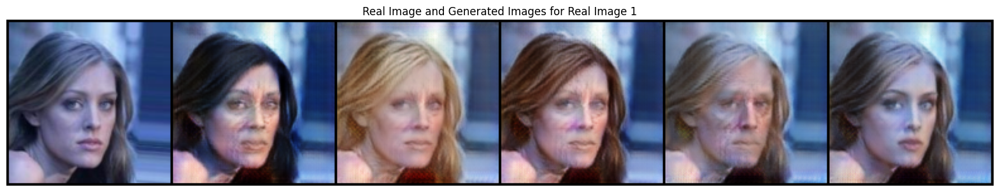

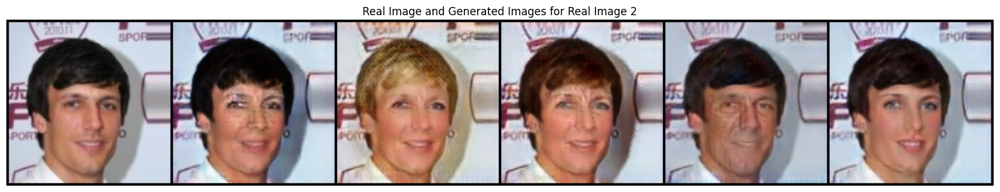

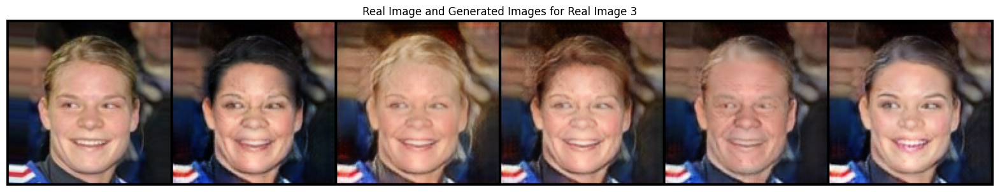

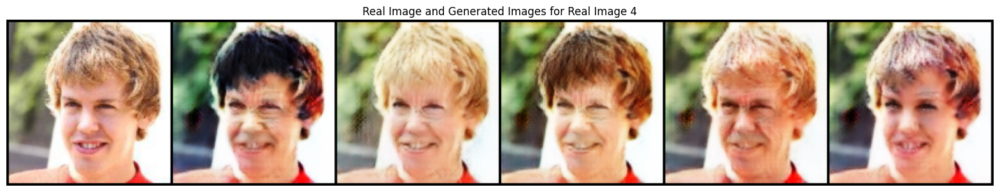

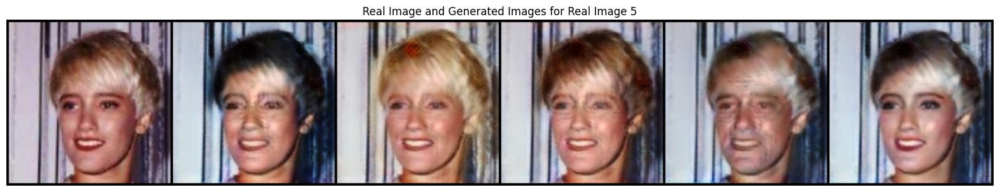

Iteration [76000/200000] - Epoch Losses: D/adv_real: -1.7627, D/adv_fake: 0.8510, D/cls: 1.0191, D/gp: 0.0069, G/adv: -0.1275, G/rec: 0.0176, G/cls: 0.0871 - Time Elapsed: 36m 12s - Time Left: 59m 4s
Iteration [77000/200000] - Epoch Losses: D/adv_real: -1.7202, D/adv_fake: 0.8075, D/cls: 1.0516, D/gp: 0.0071, G/adv: -0.1136, G/rec: 0.0174, G/cls: 0.0879 - Time Elapsed: 42m 14s - Time Left: 67m 27s
Iteration [78000/200000] - Epoch Losses: D/adv_real: -1.8895, D/adv_fake: 0.9793, D/cls: 1.0342, D/gp: 0.0069, G/adv: -0.1600, G/rec: 0.0172, G/cls: 0.0894 - Time Elapsed: 48m 15s - Time Left: 75m 27s
Iteration [79000/200000] - Epoch Losses: D/adv_real: -1.6820, D/adv_fake: 0.7936, D/cls: 1.0170, D/gp: 0.0070, G/adv: -0.1202, G/rec: 0.0172, G/cls: 0.0832 - Time Elapsed: 54m 15s - Time Left: 83m 6s
Iteration [80000/200000] - Epoch Losses: D/adv_real: -1.7235, D/adv_fake: 0.8323, D/cls: 1.0298, D/gp: 0.0069, G/adv: -0.1227, G/rec: 0.0169, G/cls: 0.0862 - Time Elapsed: 60m 16s - Time Left: 90m 2

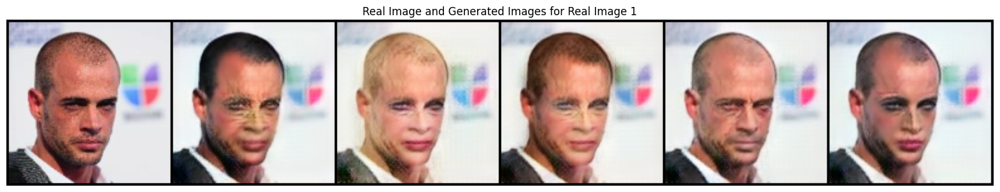

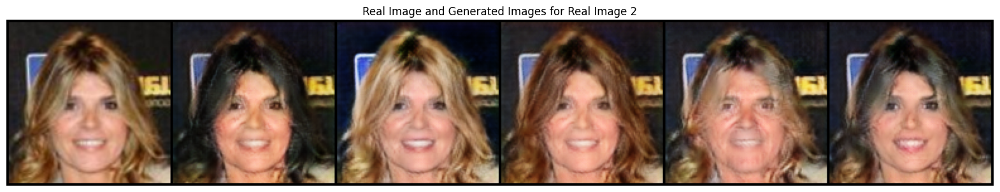

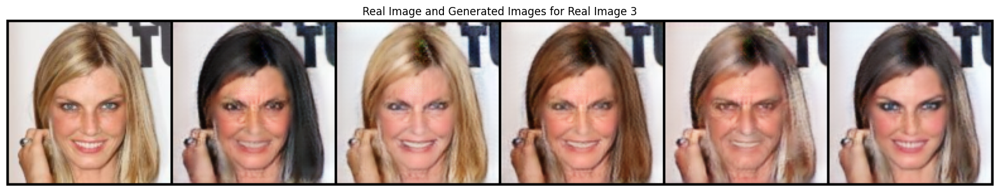

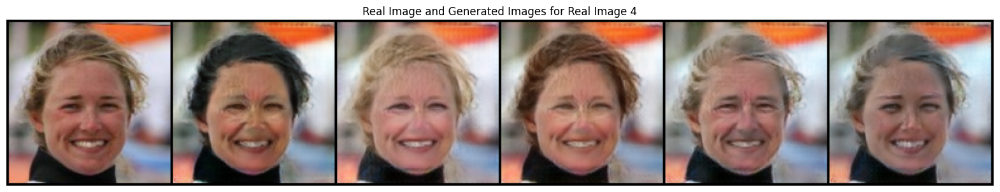

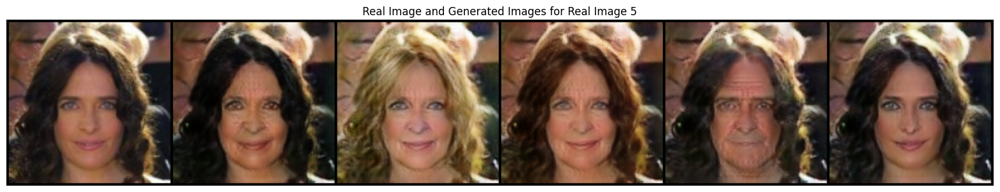

Checkpoint saved at iteration 80000 to checkpoints/checkpoint.pth
Iteration [81000/200000] - Epoch Losses: D/adv_real: -1.7387, D/adv_fake: 0.8565, D/cls: 1.0242, D/gp: 0.0066, G/adv: -0.1321, G/rec: 0.0167, G/cls: 0.0835 - Time Elapsed: 66m 21s - Time Left: 97m 28s
Iteration [82000/200000] - Epoch Losses: D/adv_real: -1.7637, D/adv_fake: 0.8958, D/cls: 1.0160, D/gp: 0.0068, G/adv: -0.1438, G/rec: 0.0166, G/cls: 0.0819 - Time Elapsed: 72m 22s - Time Left: 104m 8s


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Iteration [83000/200000] - Epoch Losses: D/adv_real: -1.7288, D/adv_fake: 0.8419, D/cls: 1.0206, D/gp: 0.0067, G/adv: -0.1228, G/rec: 0.0167, G/cls: 0.0809 - Time Elapsed: 78m 28s - Time Left: 110m 36s
Iteration [84000/200000] - Epoch Losses: D/adv_real: -1.6531, D/adv_fake: 0.7719, D/cls: 0.9974, D/gp: 0.0070, G/adv: -0.1062, G/rec: 0.0166, G/cls: 0.0844 - Time Elapsed: 84m 29s - Time Left: 116m 40s
Iteration [85000/200000] - Epoch Losses: D/adv_real: -1.8493, D/adv_fake: 0.9542, D/cls: 0.9993, D/gp: 0.0073, G/adv: -0.1487, G/rec: 0.0170, G/cls: 0.0805 - Time Elapsed: 90m 29s - Time Left: 122m 26s


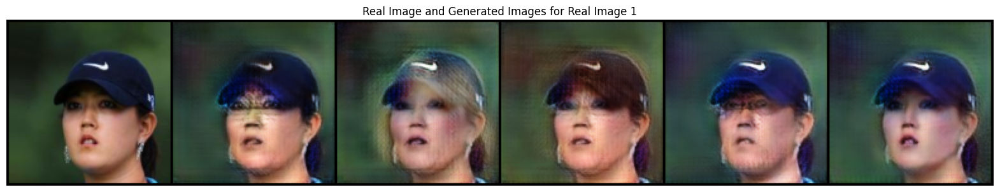

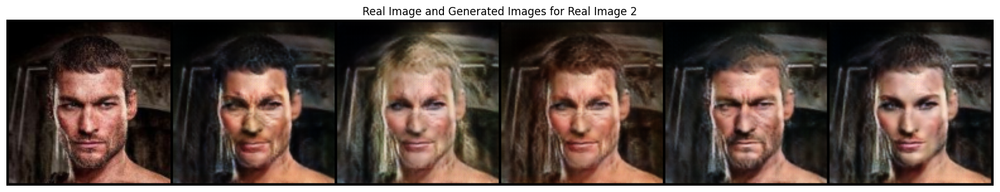

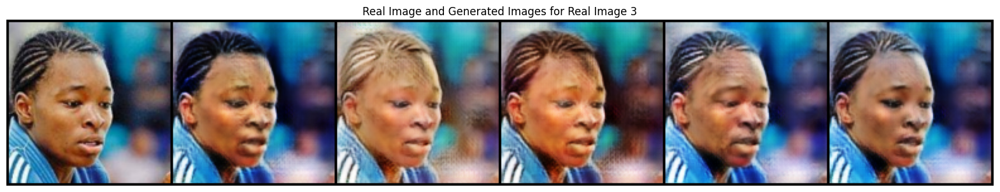

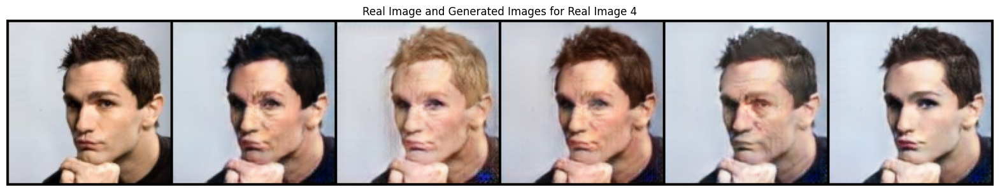

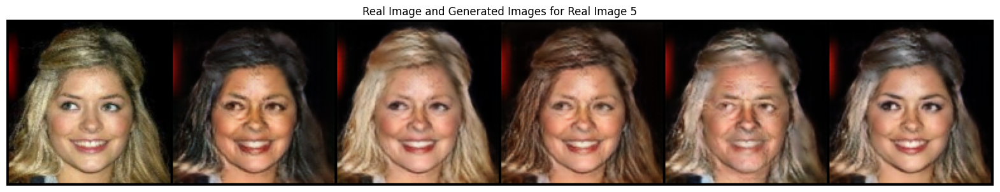

Iteration [86000/200000] - Epoch Losses: D/adv_real: -1.6653, D/adv_fake: 0.8020, D/cls: 1.0008, D/gp: 0.0065, G/adv: -0.1139, G/rec: 0.0163, G/cls: 0.0819 - Time Elapsed: 96m 33s - Time Left: 127m 59s
Iteration [87000/200000] - Epoch Losses: D/adv_real: -1.6505, D/adv_fake: 0.7749, D/cls: 1.0156, D/gp: 0.0066, G/adv: -0.1144, G/rec: 0.0164, G/cls: 0.0825 - Time Elapsed: 102m 34s - Time Left: 133m 14s
Iteration [88000/200000] - Epoch Losses: D/adv_real: -1.6157, D/adv_fake: 0.7453, D/cls: 0.9853, D/gp: 0.0066, G/adv: -0.1078, G/rec: 0.0163, G/cls: 0.0823 - Time Elapsed: 108m 36s - Time Left: 138m 13s
Iteration [89000/200000] - Epoch Losses: D/adv_real: -1.6793, D/adv_fake: 0.8116, D/cls: 1.0156, D/gp: 0.0067, G/adv: -0.1165, G/rec: 0.0164, G/cls: 0.0817 - Time Elapsed: 114m 37s - Time Left: 142m 56s
Iteration [90000/200000] - Epoch Losses: D/adv_real: -1.8433, D/adv_fake: 0.9712, D/cls: 1.0111, D/gp: 0.0068, G/adv: -0.1515, G/rec: 0.0163, G/cls: 0.0836 - Time Elapsed: 120m 38s - Time L

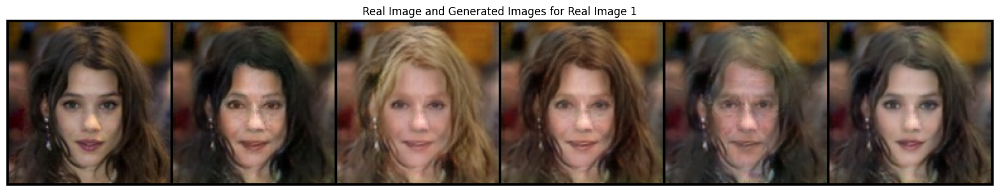

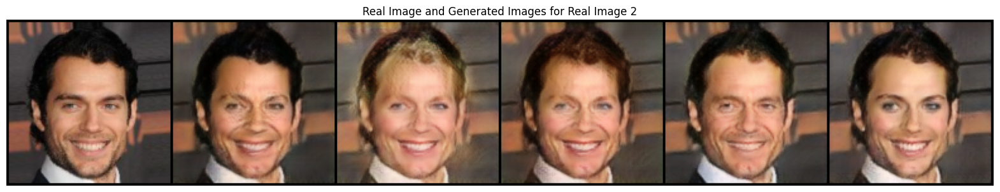

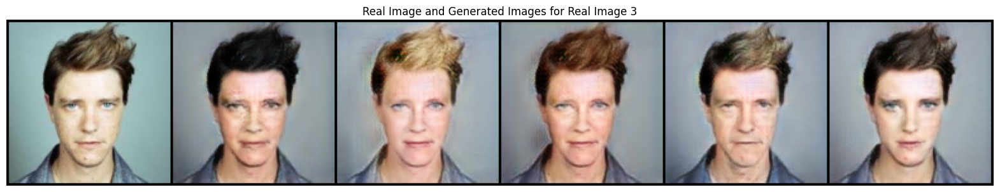

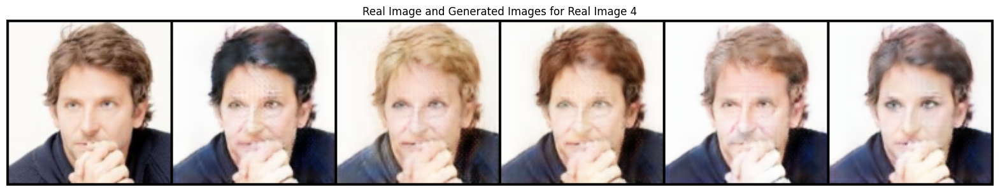

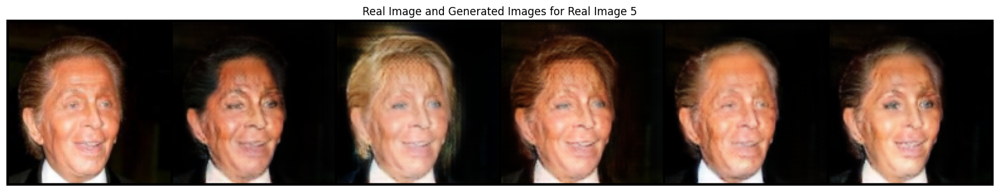

Checkpoint saved at iteration 90000 to checkpoints/checkpoint.pth
Iteration [91000/200000] - Epoch Losses: D/adv_real: -1.7068, D/adv_fake: 0.8466, D/cls: 1.0283, D/gp: 0.0066, G/adv: -0.1242, G/rec: 0.0163, G/cls: 0.0828 - Time Elapsed: 126m 43s - Time Left: 151m 47s
Iteration [92000/200000] - Epoch Losses: D/adv_real: -1.6866, D/adv_fake: 0.8397, D/cls: 0.9899, D/gp: 0.0067, G/adv: -0.1258, G/rec: 0.0161, G/cls: 0.0778 - Time Elapsed: 132m 44s - Time Left: 155m 50s
Iteration [93000/200000] - Epoch Losses: D/adv_real: -1.7345, D/adv_fake: 0.8800, D/cls: 1.0119, D/gp: 0.0067, G/adv: -0.1347, G/rec: 0.0161, G/cls: 0.0812 - Time Elapsed: 138m 46s - Time Left: 159m 39s
Iteration [94000/200000] - Epoch Losses: D/adv_real: -1.7497, D/adv_fake: 0.9170, D/cls: 1.0045, D/gp: 0.0064, G/adv: -0.1485, G/rec: 0.0155, G/cls: 0.0800 - Time Elapsed: 144m 47s - Time Left: 163m 16s
Iteration [95000/200000] - Epoch Losses: D/adv_real: -1.7091, D/adv_fake: 0.8789, D/cls: 1.0214, D/gp: 0.0064, G/adv: -0.1

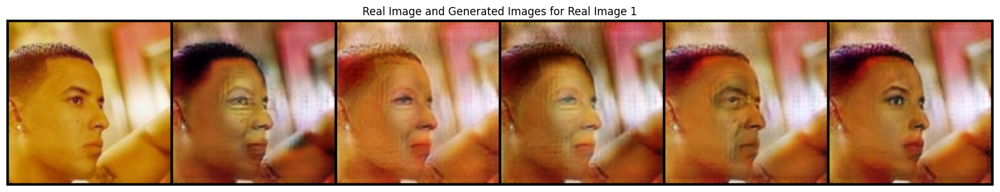

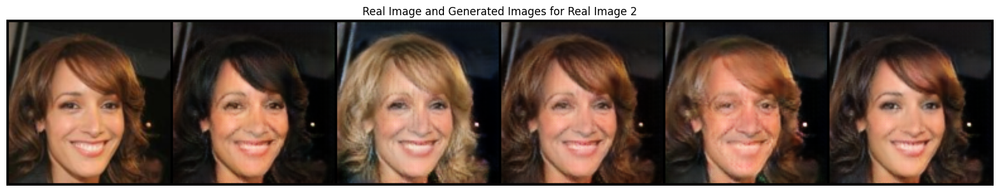

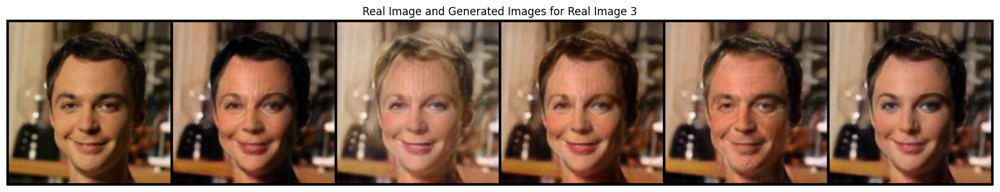

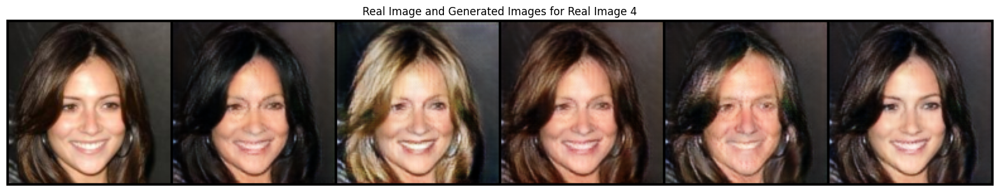

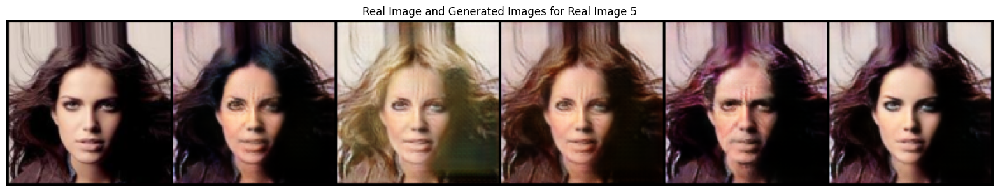

Iteration [96000/200000] - Epoch Losses: D/adv_real: -1.7218, D/adv_fake: 0.9029, D/cls: 0.9903, D/gp: 0.0063, G/adv: -0.1437, G/rec: 0.0157, G/cls: 0.0801 - Time Elapsed: 156m 53s - Time Left: 169m 58s
Iteration [97000/200000] - Epoch Losses: D/adv_real: -1.8387, D/adv_fake: 0.9813, D/cls: 0.9970, D/gp: 0.0067, G/adv: -0.1568, G/rec: 0.0159, G/cls: 0.0772 - Time Elapsed: 162m 54s - Time Left: 172m 59s
Iteration [98000/200000] - Epoch Losses: D/adv_real: -1.6897, D/adv_fake: 0.8442, D/cls: 1.0020, D/gp: 0.0066, G/adv: -0.1296, G/rec: 0.0156, G/cls: 0.0808 - Time Elapsed: 168m 55s - Time Left: 175m 49s
Iteration [99000/200000] - Epoch Losses: D/adv_real: -1.9025, D/adv_fake: 1.0512, D/cls: 0.9933, D/gp: 0.0071, G/adv: -0.1678, G/rec: 0.0157, G/cls: 0.0786 - Time Elapsed: 174m 56s - Time Left: 178m 28s
Iteration [100000/200000] - Epoch Losses: D/adv_real: -1.9177, D/adv_fake: 1.0807, D/cls: 0.9764, D/gp: 0.0066, G/adv: -0.1752, G/rec: 0.0154, G/cls: 0.0844 - Time Elapsed: 180m 57s - Time

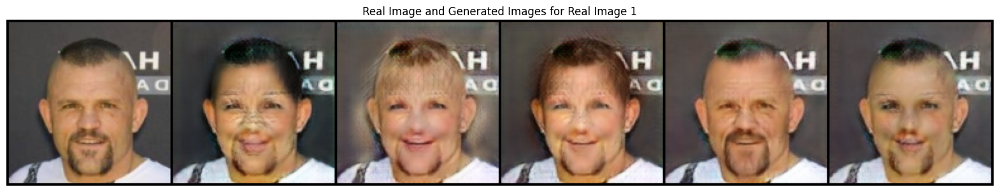

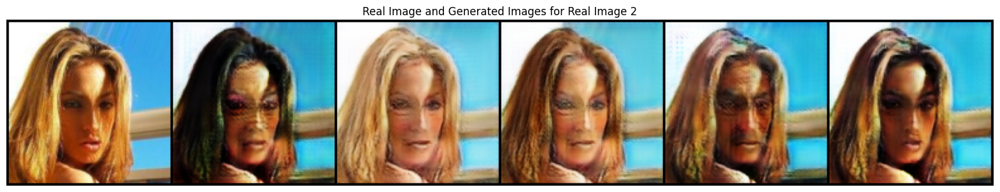

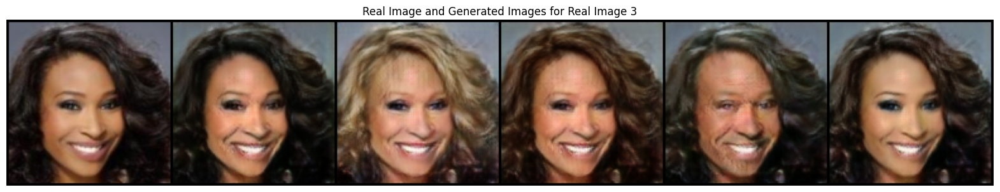

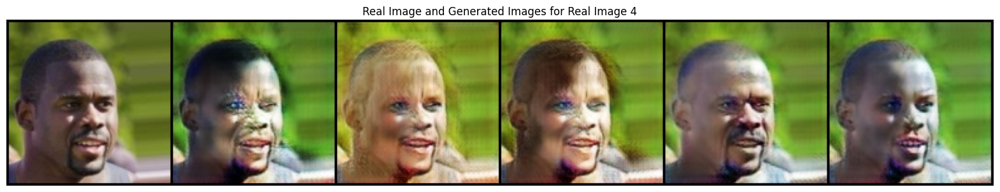

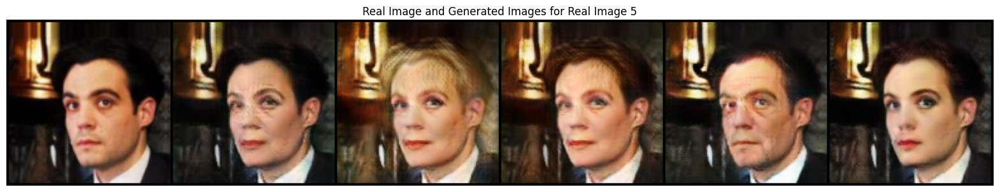

Checkpoint saved at iteration 100000 to checkpoints/checkpoint.pth
Iteration [101000/200000] - Epoch Losses: D/adv_real: -2.0286, D/adv_fake: 1.1925, D/cls: 0.9889, D/gp: 0.0067, G/adv: -0.1942, G/rec: 0.0157, G/cls: 0.0776 - Time Elapsed: 187m 3s - Time Left: 183m 20s
Iteration [102000/200000] - Epoch Losses: D/adv_real: -2.0257, D/adv_fake: 1.1987, D/cls: 0.9935, D/gp: 0.0063, G/adv: -0.2026, G/rec: 0.0153, G/cls: 0.0801 - Time Elapsed: 193m 3s - Time Left: 185m 29s
Iteration [103000/200000] - Epoch Losses: D/adv_real: -1.8523, D/adv_fake: 0.9932, D/cls: 0.9972, D/gp: 0.0070, G/adv: -0.1540, G/rec: 0.0156, G/cls: 0.0760 - Time Elapsed: 199m 4s - Time Left: 187m 29s
Iteration [104000/200000] - Epoch Losses: D/adv_real: -1.8636, D/adv_fake: 1.0430, D/cls: 0.9889, D/gp: 0.0065, G/adv: -0.1705, G/rec: 0.0154, G/cls: 0.0715 - Time Elapsed: 205m 5s - Time Left: 189m 19s
Iteration [105000/200000] - Epoch Losses: D/adv_real: -1.8300, D/adv_fake: 1.0076, D/cls: 0.9812, D/gp: 0.0064, G/adv: -0

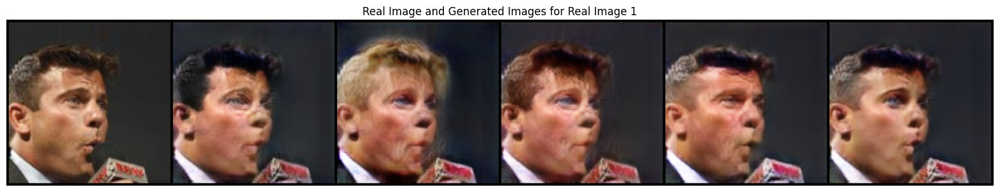

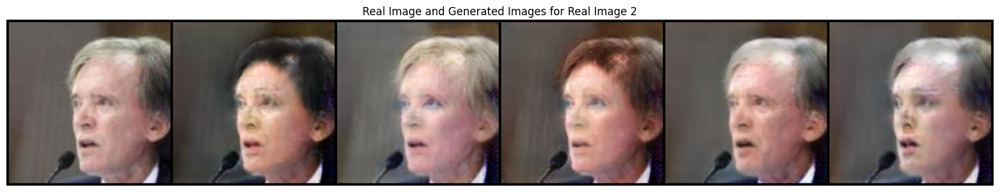

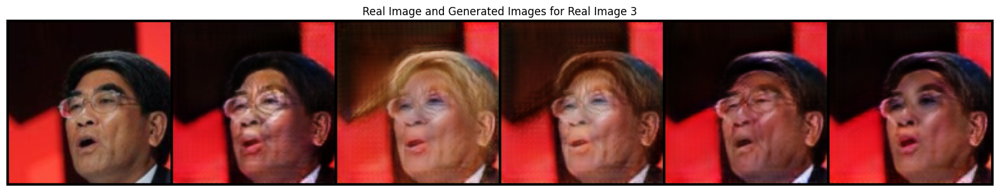

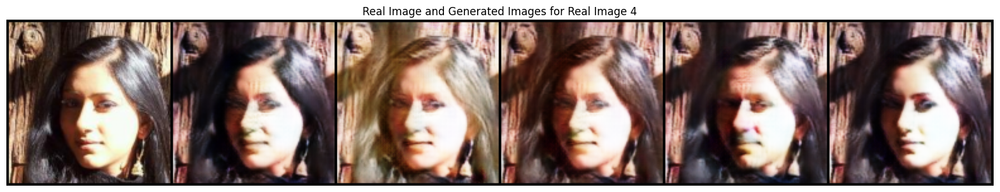

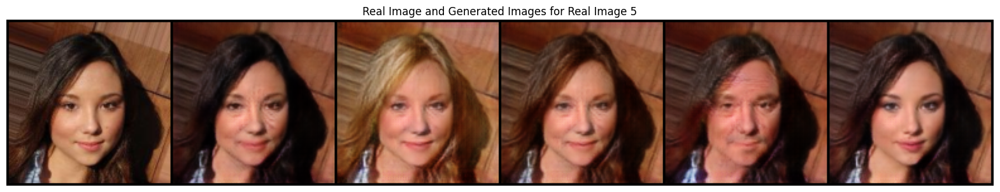

Iteration [106000/200000] - Epoch Losses: D/adv_real: -1.7698, D/adv_fake: 0.9389, D/cls: 0.9826, D/gp: 0.0066, G/adv: -0.1410, G/rec: 0.0152, G/cls: 0.0764 - Time Elapsed: 217m 9s - Time Left: 192m 34s
Iteration [107000/200000] - Epoch Losses: D/adv_real: -1.8425, D/adv_fake: 1.0289, D/cls: 0.9902, D/gp: 0.0064, G/adv: -0.1671, G/rec: 0.0147, G/cls: 0.0756 - Time Elapsed: 223m 10s - Time Left: 193m 58s
Iteration [108000/200000] - Epoch Losses: D/adv_real: -2.0995, D/adv_fake: 1.2975, D/cls: 0.9729, D/gp: 0.0065, G/adv: -0.2202, G/rec: 0.0147, G/cls: 0.0733 - Time Elapsed: 229m 12s - Time Left: 195m 14s
Iteration [109000/200000] - Epoch Losses: D/adv_real: -1.9797, D/adv_fake: 1.1579, D/cls: 0.9664, D/gp: 0.0065, G/adv: -0.1929, G/rec: 0.0149, G/cls: 0.0787 - Time Elapsed: 235m 13s - Time Left: 196m 22s
Iteration [110000/200000] - Epoch Losses: D/adv_real: -2.0030, D/adv_fake: 1.1653, D/cls: 0.9562, D/gp: 0.0065, G/adv: -0.1974, G/rec: 0.0149, G/cls: 0.0752 - Time Elapsed: 241m 14s - T

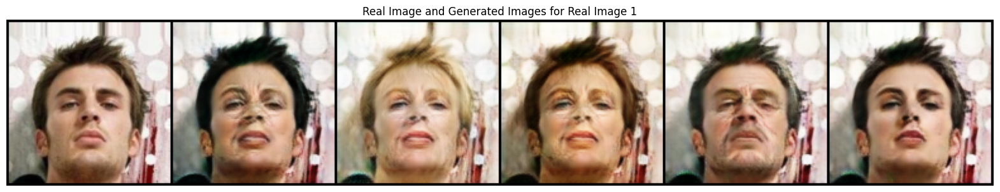

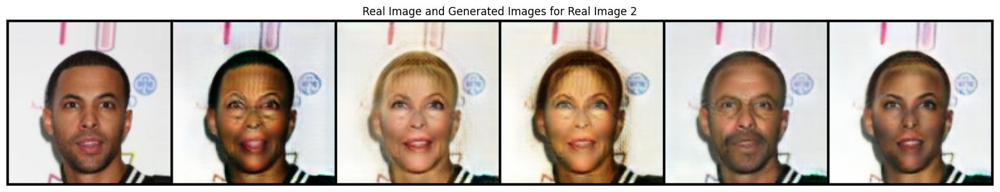

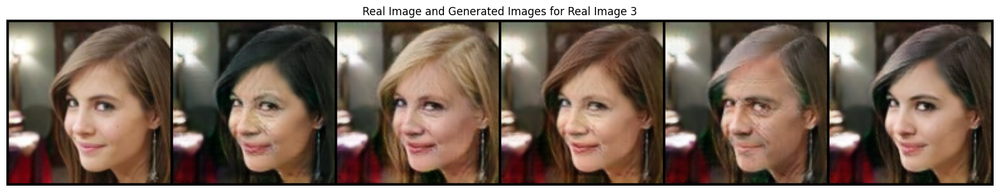

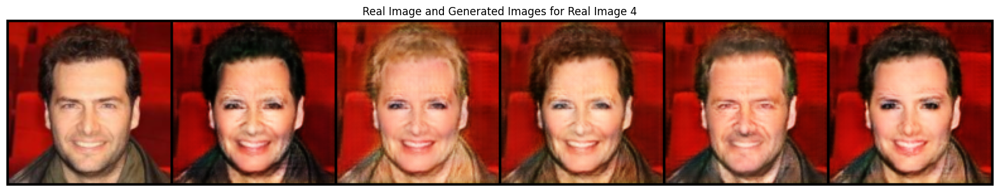

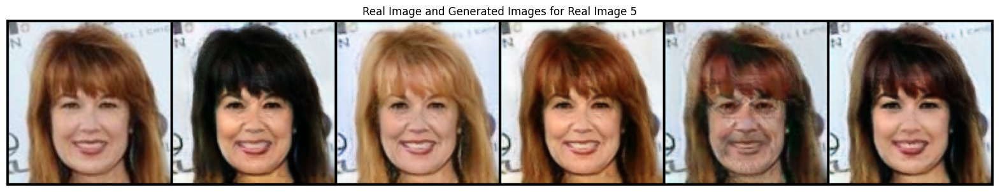

Checkpoint saved at iteration 110000 to checkpoints/checkpoint.pth
Iteration [111000/200000] - Epoch Losses: D/adv_real: -1.8514, D/adv_fake: 1.0118, D/cls: 0.9802, D/gp: 0.0065, G/adv: -0.1644, G/rec: 0.0148, G/cls: 0.0787 - Time Elapsed: 247m 19s - Time Left: 198m 18s
Iteration [112000/200000] - Epoch Losses: D/adv_real: -1.6441, D/adv_fake: 0.8377, D/cls: 0.9964, D/gp: 0.0063, G/adv: -0.1286, G/rec: 0.0147, G/cls: 0.0776 - Time Elapsed: 253m 20s - Time Left: 199m 3s
Iteration [113000/200000] - Epoch Losses: D/adv_real: -1.7120, D/adv_fake: 0.9018, D/cls: 0.9707, D/gp: 0.0062, G/adv: -0.1436, G/rec: 0.0148, G/cls: 0.0740 - Time Elapsed: 259m 21s - Time Left: 199m 41s
Iteration [114000/200000] - Epoch Losses: D/adv_real: -1.6862, D/adv_fake: 0.8751, D/cls: 0.9690, D/gp: 0.0064, G/adv: -0.1358, G/rec: 0.0149, G/cls: 0.0776 - Time Elapsed: 265m 22s - Time Left: 200m 11s
Iteration [115000/200000] - Epoch Losses: D/adv_real: -1.8163, D/adv_fake: 1.0166, D/cls: 0.9910, D/gp: 0.0066, G/adv:

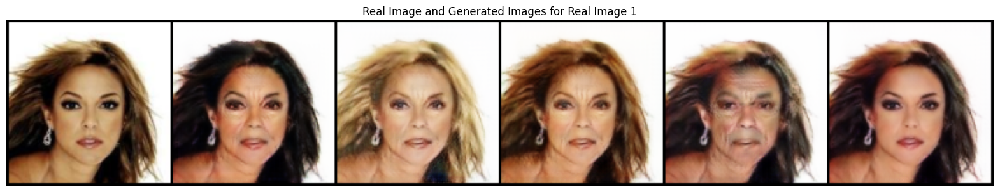

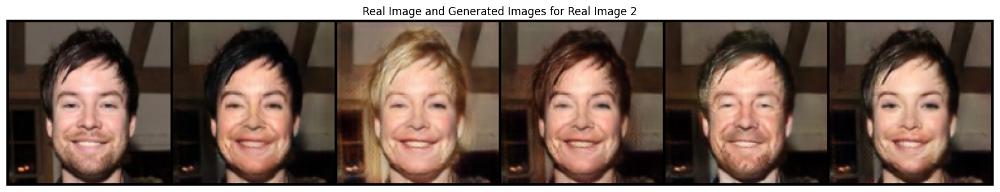

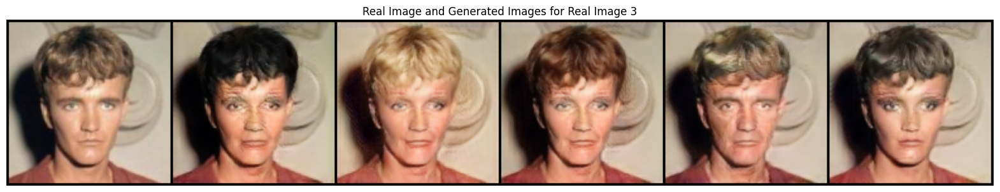

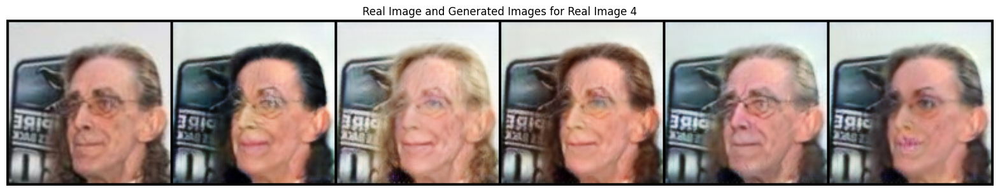

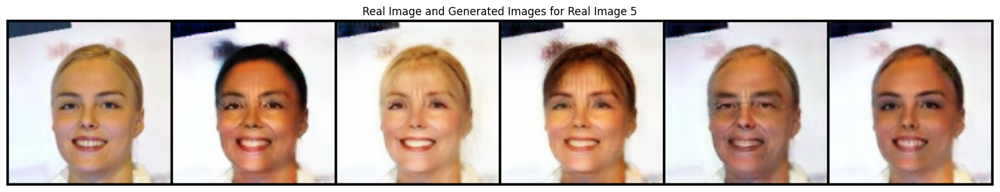

Iteration [116000/200000] - Epoch Losses: D/adv_real: -1.8875, D/adv_fake: 1.0835, D/cls: 0.9623, D/gp: 0.0063, G/adv: -0.1798, G/rec: 0.0145, G/cls: 0.0728 - Time Elapsed: 277m 26s - Time Left: 200m 54s
Iteration [117000/200000] - Epoch Losses: D/adv_real: -1.6208, D/adv_fake: 0.8224, D/cls: 0.9757, D/gp: 0.0064, G/adv: -0.1265, G/rec: 0.0146, G/cls: 0.0763 - Time Elapsed: 283m 27s - Time Left: 201m 5s
Iteration [118000/200000] - Epoch Losses: D/adv_real: -1.7802, D/adv_fake: 0.9696, D/cls: 0.9787, D/gp: 0.0064, G/adv: -0.1601, G/rec: 0.0145, G/cls: 0.0767 - Time Elapsed: 289m 27s - Time Left: 201m 9s
Iteration [119000/200000] - Epoch Losses: D/adv_real: -1.7300, D/adv_fake: 0.9348, D/cls: 0.9796, D/gp: 0.0061, G/adv: -0.1524, G/rec: 0.0143, G/cls: 0.0730 - Time Elapsed: 295m 28s - Time Left: 201m 7s
Iteration [120000/200000] - Epoch Losses: D/adv_real: -1.6250, D/adv_fake: 0.8337, D/cls: 0.9677, D/gp: 0.0063, G/adv: -0.1291, G/rec: 0.0145, G/cls: 0.0737 - Time Elapsed: 301m 29s - Tim

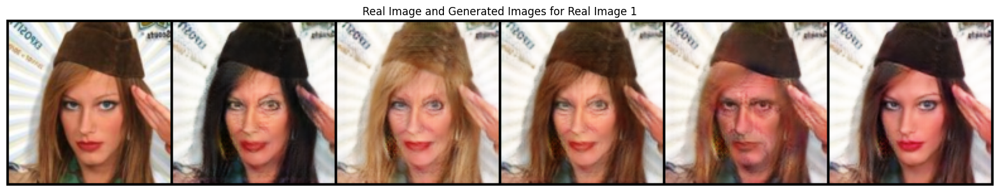

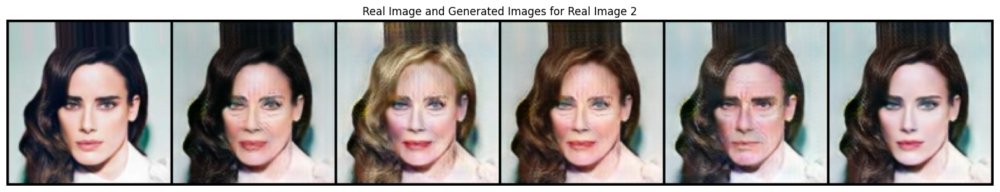

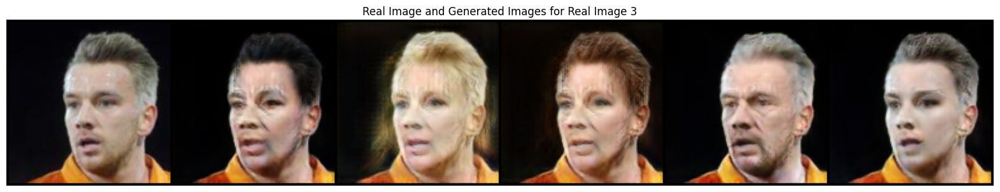

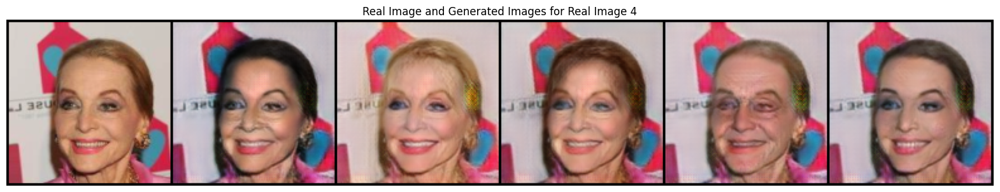

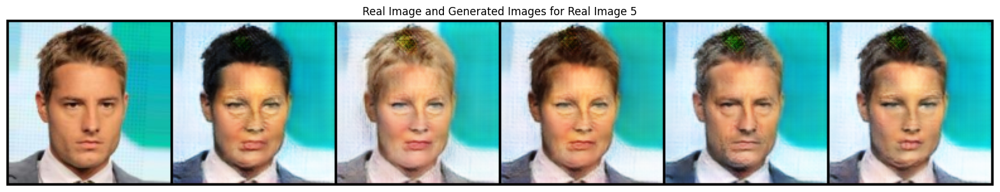

Checkpoint saved at iteration 120000 to checkpoints/checkpoint.pth


KeyboardInterrupt: 

In [7]:
import argparse
import json
import os
import torch
from torch.utils.tensorboard import SummaryWriter


class Cfg:
    pass


def importAndProcessConfigs(parser, config_file="/kaggle/input/stargan/NNconfig.json"):
    # Load configurations from the JSON file
    with open(config_file, "r") as f:
        argSettings = json.load(f)

    # Get the existing arguments to avoid re-adding them
    existing_args = {action.dest for action in parser._actions}

    for setting in argSettings:
        arg_name = setting.pop("name")

        # Only add the argument if it hasn't been provided in the command line
        if arg_name not in existing_args:
            posArgs = ["--" + arg_name]
            if "list" in setting:
                setting.pop("list")
                posArgs.append("--list")

            # Convert type
            if "type" in setting:
                setting["type"] = int if setting["type"] == "int" else float if setting["type"] == "float" else str
            if "default" in setting and setting["default"] == "None":
                setting["default"] = None

            parser.add_argument(*posArgs, **setting)


def loadConfig(config_file="/kaggle/input/stargan/NNconfig.json"):
    with open(config_file, "r") as f:
        argSettings = json.load(f)
    
    cfg = Cfg()
    for setting in argSettings:
        if "default" in setting and setting["default"] == "None":
            setting["default"] = None
        setattr(cfg, setting["name"], setting["default"])
    return cfg


def prepareDirs(config):
    # Create directories if not exist.
    dirs = [config.log_dir, config.model_save_dir, config.sample_dir, config.result_dir, config.checkpoint_save_dir]
    for directory in dirs:
        if not os.path.exists(directory):
            os.makedirs(directory)
            
def load_checkpoint(config, G, D, g_optimizer, d_optimizer, device):
    start_iter = 0

    if config.checkpoint_load_dir and os.path.exists(config.checkpoint_load_dir):
        checkpoint = torch.load(config.checkpoint_load_dir, map_location=device)
        G.load_state_dict(checkpoint['model_G_state_dict'])
        D.load_state_dict(checkpoint['model_D_state_dict'])
        
        # Load optimizers' state dict
        g_optimizer.load_state_dict(checkpoint['optimizer_G_state_dict'])
        d_optimizer.load_state_dict(checkpoint['optimizer_D_state_dict'])
        
        # Load iteration
        start_iter = checkpoint['iteration']
        print(f"Checkpoint loaded: starting from iteration {start_iter}")
    else:
        print("No checkpoint found. Starting from scratch.")

    return G, D, g_optimizer, d_optimizer, start_iter


def main(config):
    # For fast training.
    torch.backends.cudnn.benchmark = True
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # Running preparation
    prepareDirs(config)
    writer = SummaryWriter(config.log_dir)

    # Data preparation
    data_loader = getProperLoader(config)

    # Model Initialization
    G = Generator(config.g_conv_dim, config.c_dim, config.g_repeat_num)
    D = Discriminator(config.image_size, config.d_conv_dim, config.c_dim, config.d_repeat_num)
    g_optimizer = torch.optim.Adam(G.parameters(), config.g_lr, [config.beta1, config.beta2])
    d_optimizer = torch.optim.Adam(D.parameters(), config.d_lr, [config.beta1, config.beta2])
    G.to(device)
    D.to(device)
    G, D, g_optimizer, d_optimizer, start_iter = load_checkpoint(config, G, D, g_optimizer, d_optimizer, device)

    # If no checkpoint was found, start_iter will be 0
    iters = max(start_iter, 0)

    print(f'Starting from iteration {iters}')
    
    print(f'DataLoader length: {len(data_loader)}')
#     print(type(data_loader))    
#     first_batch = next(iter(data_loader))
#     inputs, labels = first_batch
#     print(f'Inputs: {inputs[0]}')
#     print(f'Labels: {labels[0]}')
#     print(f'Type labels: {type(labels[0])}')


    log_dict_images = {}
    # Training/Test
    if config.mode == 'train':
        log_dict_images = train(config, G, D, g_optimizer, d_optimizer, data_loader, device, writer, iters)
        
    elif config.mode == 'test':
        test(config, G, data_loader, device)


# Argument parser setup
parser = argparse.ArgumentParser()

# Add common arguments
parser.add_argument('--mode', type=str, default=None, help='Mode (train/test)')
parser.add_argument('--dataset', type=str, default=None, help='Dataset name')
parser.add_argument('--image_size', type=int, default=None, help='Image size')
parser.add_argument('--c_dim', type=int, default=None, help='Number of classes/attributes')
parser.add_argument('--sample_dir', type=str, default=None, help='Directory to save samples')
parser.add_argument('--log_dir', type=str, default=None, help='Directory to save logs')
parser.add_argument('--model_save_dir', type=str, default=None, help='Directory to save models')
parser.add_argument('--result_dir', type=str, default=None, help='Directory to save results')
parser.add_argument('--selected_attrs', nargs='+', default=None, help='List of selected attributes')
parser.add_argument('--celeba_image_dir', type=str, default=None, help='Celeb Images Path')
parser.add_argument('--attr_path', type=str, default=None, help='Celeb Attribute file path')
parser.add_argument('--num_workers', type=int, default=None, help='Workers for data loader')
parser.add_argument('--checkpoint_load_dir', type=str, default=None, help='Checkpoint load directory')
parser.add_argument('--checkpoint_save_dir', type=str, default=None, help='Checkpoint save directory')





# Parse initial arguments (for testing purposes)
args, unknown = parser.parse_known_args([
    '--mode', 'train',
    '--dataset', 'CelebA',
    '--image_size', '128',
    '--c_dim', '5',
    '--sample_dir', 'trial1/samples',
    '--log_dir', 'trial1/logs',
    '--model_save_dir', 'trial1/models',
    '--result_dir', 'trial1/results',
    '--selected_attrs', 'Black_Hair', 'Blond_Hair', 'Brown_Hair', 'Male', 'Young',
    '--celeba_image_dir', '/kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba',
    '--attr_path', '/kaggle/input/celeba-dataset/list_attr_celeba.csv',
    '--num_workers', '1',
    '--checkpoint_load_dir', '/kaggle/input/stargan/checkpoint.pth',
    '--checkpoint_save_dir', 'checkpoints',
])

# Load JSON configuration into config object
config_json = loadConfig()

# Import and process additional arguments from JSON configuration
importAndProcessConfigs(parser)

# Override JSON configurations with command-line arguments if provided
for key, value in vars(args).items():
    if value is not None:
        setattr(config_json, key, value)

# Final configuration object
config = config_json

# !pkill -9 python

# Run the main function with the final configuration
if __name__ == '__main__':
    main(config)
# print(vars(config))


In [9]:
folder_to_zip = 'checkpoints'  # Replace with your folder path
output_filename = 'checkpoints'  # Replace with your desired output filename

shutil.make_archive(output_filename, 'zip', folder_to_zip)

# Step 2: Download the Zipped Folder
FileLink(output_filename + '.zip')

/kaggle/working/checkpoints.zip

In [ ]:
G = Generator()
D = Discriminator()
G

In [ ]:
D